In [1]:
import chromadb

chroma_client = chromadb.HttpClient(host='localhost', port=8000)

In [4]:
collection = chroma_client.create_collection(name="train_data_setup" , metadata={"hnsw:space": "cosine"})

In [5]:
import cv2
import torch
from PIL import Image
from transformers import CLIPProcessor, CLIPModel
import numpy as np
import torchvision.transforms as transforms
import os
os.environ["TOKENIZERS_PARALLELISM"] = "true"


model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

def encode_text(query):
    inputs = processor(text=[query], return_tensors="pt", padding=True)
    with torch.no_grad():
        text_features = model.get_text_features(**inputs)
    return text_features

def encode_images(frames):
    inputs = processor(images=frames, return_tensors="pt", padding=True)
    with torch.no_grad():
        image_features = model.get_image_features(**inputs)
    return image_features

def insert_video_embeddings_to_db(video_path, every_n=10, grid_size=(3, 3), batch_size = 500):
    cap = cv2.VideoCapture(video_path)
    data = {
        "ids":[],
        "images":[],
        "metadatas":[]
    }
    frame_id = []
    frame_idx = 0
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        if frame_idx % every_n == 0:
            if frame_idx % 500==0:
                print(f"Processing frame {frame_idx}")
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            pil_image = Image.fromarray(frame_rgb)
            width, height = pil_image.size
            grid_width = width // grid_size[0]
            grid_height = height // grid_size[1]
            
            # Crop the frame into grid_size (e.g., 3x3 or 2x2)
            for i in range(grid_size[0]):
                for j in range(grid_size[1]):
                    left = i * grid_width
                    upper = j * grid_height
                    right = (i + 1) * grid_width
                    lower = (j + 1) * grid_height
                    cropped_frame = pil_image.crop((left, upper, right, lower))
                    data["images"].append(cropped_frame)
                    data["metadatas"].append({
                        "video_name": video_path,
                        "frame_number": frame_idx,
                        "crop_number": 2*i + j,
                        "frame_rate": cap.get(cv2.CAP_PROP_FPS),
                    })
                    frame_uid = f"{video_path}_frame_{frame_idx}_crop_{i+1}{j+1}"
                    if frame_uid in frame_id:
                        print(f"Frame {frame_uid} already exists in the database.")
                        continue 
                    
                    frame_id.append(frame_uid)
                    
                    data["ids"].append(frame_uid)
                    if len(data["metadatas"]) == batch_size:
                        data["embeddings"] = encode_images(data["images"]).numpy()
                        data["images"] = [np.array(x) for x in data["images"]]
                        collection.add(**data)
                        data = {
                            "ids":[],
                            "images":[],
                            "metadatas":[]
                        }
        frame_idx += 1
    cap.release()


/Users/ramachandrank/Repos/MS/SEM2/DL/Project/venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


In [6]:
videos = [
    "VIRAT_S_010200_04_000568_000620.mp4",
    "VIRAT_S_010201_01_000125_000152.mp4",
    "VIRAT_S_010201_02_000167_000197.mp4",
    "VIRAT_S_050301_01_000083_000320.mp4"
]

In [7]:
for video in videos:
    insert_video_embeddings_to_db(video)

Processing frame 0
Processing frame 500
Processing frame 1000
Processing frame 0
Processing frame 500
Processing frame 0
Processing frame 0
Processing frame 500
Processing frame 1000
Processing frame 1500
Processing frame 2000
Processing frame 2500
Processing frame 3000
Processing frame 3500
Processing frame 4000
Processing frame 4500
Processing frame 5000
Processing frame 5500
Processing frame 6000
Processing frame 6500
Processing frame 7000


In [33]:
insert_video_embeddings_to_db("VIRAT_S_010200_07_000748_000837.mp4")

Processing frame 0
Processing frame 500
Processing frame 1000
Processing frame 1500
Processing frame 2000


In [8]:
query = encode_text("a person in green tshirt ridiing a bicycle")
results = collection.query(
    query_embeddings=[query.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=20)

In [18]:
from collections import defaultdict
def get_video_timestamps(results, similarity_threshold = 0.5):
    
    # Initialize a dictionary to store results
    video_timestamps =  defaultdict(list)
    id_list = defaultdict(list)
    for i in range(len(results["distances"][0])):
        if results["distances"][0][i] >= similarity_threshold:
            id = results["ids"][0][i]
            frame_number = results["metadatas"][0][i]["frame_number"]
            frame_rate = results["metadatas"][0][i]["frame_rate"]
            video_name = results["metadatas"][0][i]["video_name"]  # Assuming metadata contains video_name
            timestamp = frame_number // frame_rate

            id_list[video_name].append(id)
            video_timestamps[video_name].append(frame_number)

    # Convert defaultdict to a regular dictionary
    video_timestamps = dict(video_timestamps)
    id_list = dict(id_list)
    return video_timestamps  , id_list

In [26]:
def get_frames_crop_by_video(id_list):
    all_address = {}
    for v_name , ids in id_list.items():
        frame_list = []
        position_list = []
        for id in ids:
            video_name, crop_info = id.split(".mp4_")
            _ , frame_number , _ , position = crop_info.split("_")
            i, j = position
            frame_list.append(int(frame_number))
            position_list.append( (int(i) - 1 , int(j) - 1 ) )
            
        all_address[v_name] = {
            "frame_list" : frame_list,
            "position_list" : position_list
        }    

    return all_address

In [31]:
from matplotlib import pyplot as plt
import cv2
from PIL import Image
import pandas as pd

def save_images_and_csv(all_address, query, csv_name):
    csv_data = {
        "caption": [],
        "id": [],
        "valid": []
    }

    for v_name , data in all_address.items():
        print(f"\n\nopening {v_name}\n\n")
        cap = cv2.VideoCapture(v_name)
        frame_idx = 0
        frame_list = data["frame_list"]
        position_list = data["position_list"]
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            if frame_idx in frame_list:
                frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                pil_image = Image.fromarray(frame_rgb)
                width, height = pil_image.size
                grid_width = width // 3
                grid_height = height // 3
                idx = frame_list.index(frame_idx)
                i , j = position_list[idx]
                left = i * grid_width
                upper = j * grid_height
                right = (i + 1) * grid_width
                lower = (j + 1) * grid_height

                cropped_frame = pil_image.crop((left, upper, right, lower))
                cropped_frame.save(f"train_data/{v_name}_{frame_idx}_{i+1}{j+1}.png")
                csv_data["caption"].append(query)
                csv_data["id"].append(f"train_data/{v_name}_{frame_idx}_{i+1}{j+1}.png")
                csv_data["valid"].append(0)
                plt.imshow(cropped_frame)
                plt.title(f"train_data/{v_name}_{frame_idx}_{i+1}{j+1}.png")
                plt.show()
            frame_idx += 1
        cap.release()
    
    df = pd.DataFrame(csv_data)
    df.to_csv(f"train_data/{csv_name}", index=False)


In [13]:
query = encode_text("a person in green tshirt ridiing a bicycle")
results = collection.query(
    query_embeddings=[query.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

In [20]:
video_timestamps , id_list = get_video_timestamps(results)
print(id_list)

{'VIRAT_S_050301_01_000083_000320.mp4': ['VIRAT_S_050301_01_000083_000320.mp4_frame_810_crop_23', 'VIRAT_S_050301_01_000083_000320.mp4_frame_800_crop_23', 'VIRAT_S_050301_01_000083_000320.mp4_frame_820_crop_23'], 'VIRAT_S_010200_04_000568_000620.mp4': ['VIRAT_S_010200_04_000568_000620.mp4_frame_620_crop_12', 'VIRAT_S_010200_04_000568_000620.mp4_frame_640_crop_12', 'VIRAT_S_010200_04_000568_000620.mp4_frame_630_crop_12', 'VIRAT_S_010200_04_000568_000620.mp4_frame_660_crop_12', 'VIRAT_S_010200_04_000568_000620.mp4_frame_650_crop_12', 'VIRAT_S_010200_04_000568_000620.mp4_frame_800_crop_12', 'VIRAT_S_010200_04_000568_000620.mp4_frame_680_crop_12']}


In [21]:
all_address = {}
for v_name , ids in id_list.items():
    frame_list = []
    position_list = []
    for id in ids:
        video_name, crop_info = id.split(".mp4_")
        _ , frame_number , _ , position = crop_info.split("_")
        i, j = position
        frame_list.append(int(frame_number))
        position_list.append( (int(i) - 1 , int(j) - 1 ) )
        
    all_address[v_name] = {
        "frame_list" : frame_list,
        "position_list" : position_list
    }    
     
all_address

{'VIRAT_S_050301_01_000083_000320.mp4': {'frame_list': [810, 800, 820],
  'position_list': [(1, 2), (1, 2), (1, 2)]},
 'VIRAT_S_010200_04_000568_000620.mp4': {'frame_list': [620,
   640,
   630,
   660,
   650,
   800,
   680],
  'position_list': [(0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1)]}}



opening VIRAT_S_050301_01_000083_000320.mp4




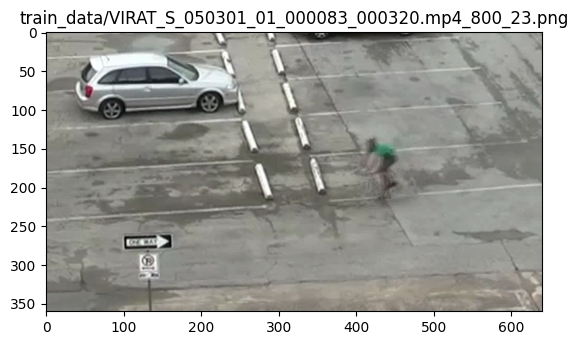

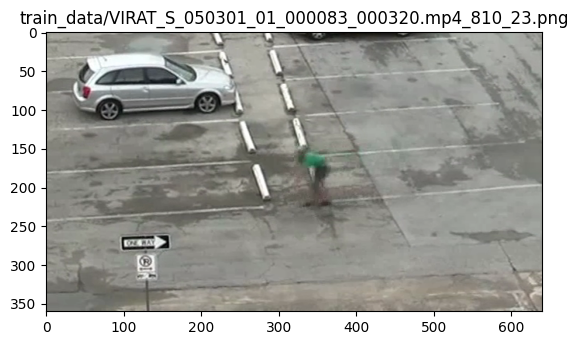

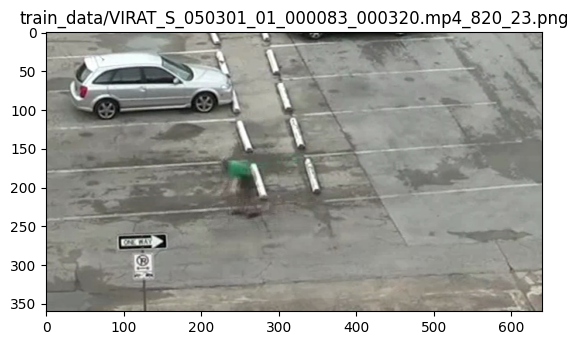



opening VIRAT_S_010200_04_000568_000620.mp4




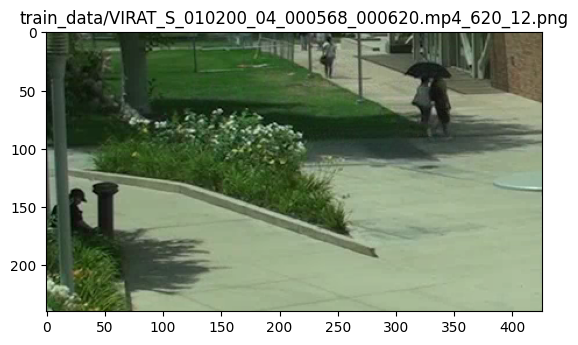

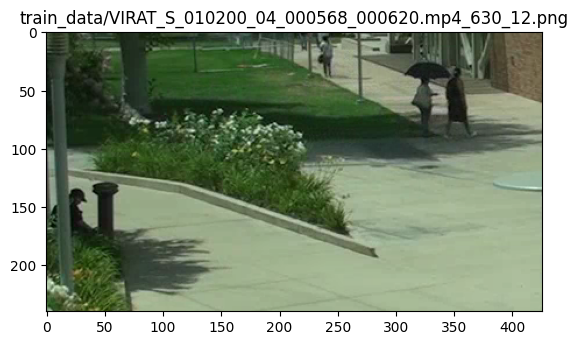

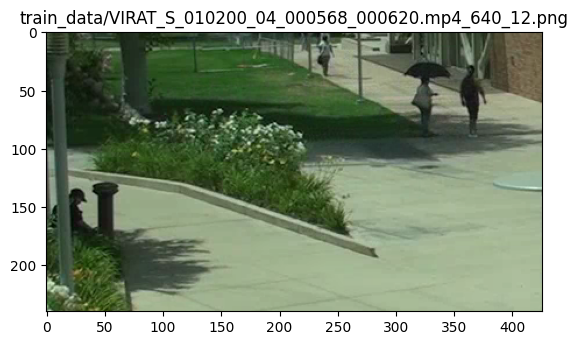

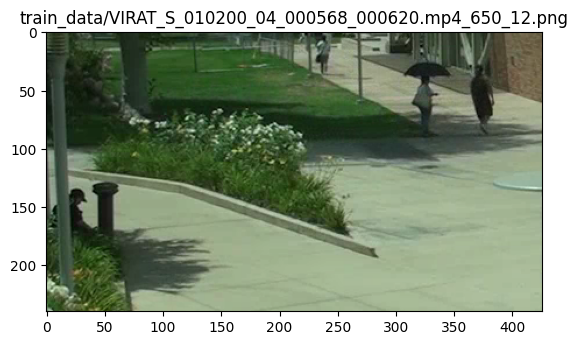

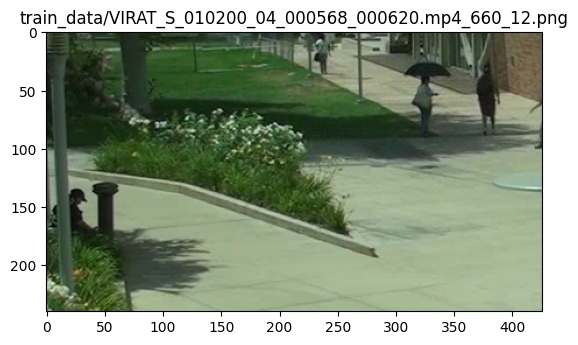

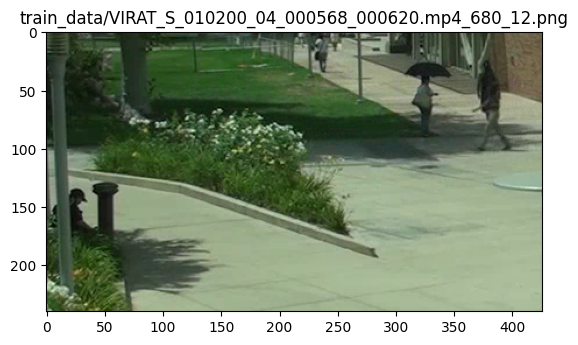

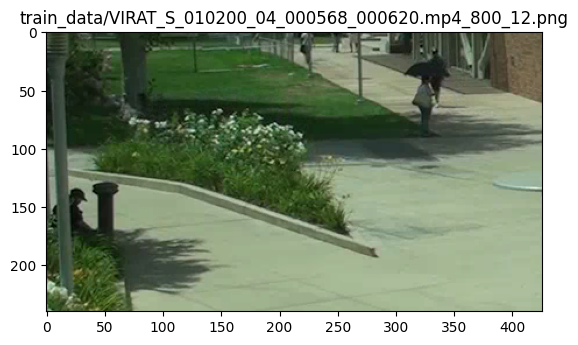

In [23]:
from matplotlib import pyplot as plt
import cv2
from PIL import Image

csv_data = {
    "caption": [],
    "id": [],
    "valid": []
}

for v_name , data in all_address.items():
    print(f"\n\nopening {v_name}\n\n")
    cap = cv2.VideoCapture(v_name)
    frame_idx = 0
    frame_list = data["frame_list"]
    position_list = data["position_list"]
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        if frame_idx in frame_list:
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            pil_image = Image.fromarray(frame_rgb)
            width, height = pil_image.size
            grid_width = width // 3
            grid_height = height // 3
            idx = frame_list.index(frame_idx)
            i , j = position_list[idx]
            left = i * grid_width
            upper = j * grid_height
            right = (i + 1) * grid_width
            lower = (j + 1) * grid_height

            cropped_frame = pil_image.crop((left, upper, right, lower))
            cropped_frame.save(f"train_data/{v_name}_{frame_idx}_{i+1}{j+1}.png")
            csv_data["caption"].append("a person in green tshirt ridiing a bicycle")
            csv_data["id"].append(f"train_data/{v_name}_{frame_idx}_{i+1}{j+1}.png")
            csv_data["valid"].append(0)
            plt.imshow(cropped_frame)
            plt.title(f"train_data/{v_name}_{frame_idx}_{i+1}{j+1}.png")
            plt.show()
        frame_idx += 1
    cap.release()


In [25]:
import pandas as pd

df = pd.DataFrame(csv_data)
df.to_csv("train_data/output.csv", index=False)
df

,caption,id,valid
0,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_050301_01_000083_000320.mp4...,0
1,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_050301_01_000083_000320.mp4...,0
2,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_050301_01_000083_000320.mp4...,0
3,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_010200_04_000568_000620.mp4...,0
4,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_010200_04_000568_000620.mp4...,0
5,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_010200_04_000568_000620.mp4...,0
6,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_010200_04_000568_000620.mp4...,0
7,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_010200_04_000568_000620.mp4...,0
8,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_010200_04_000568_000620.mp4...,0
9,a person in green tshirt ridiing a bicycle,train_data/VIRAT_S_010200_04_000568_000620.mp4...,0




opening VIRAT_S_010201_01_000125_000152.mp4




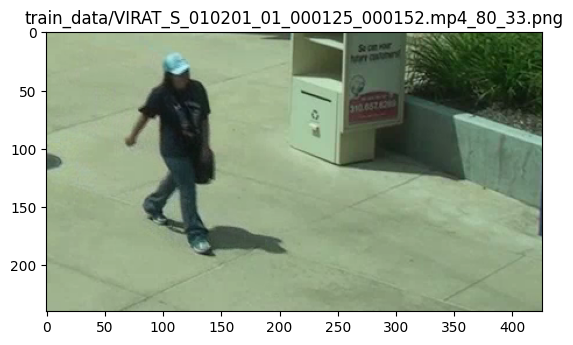

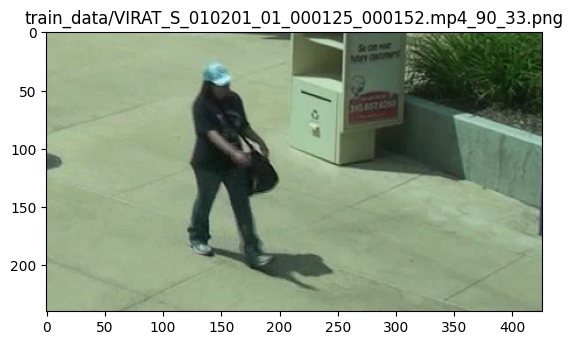

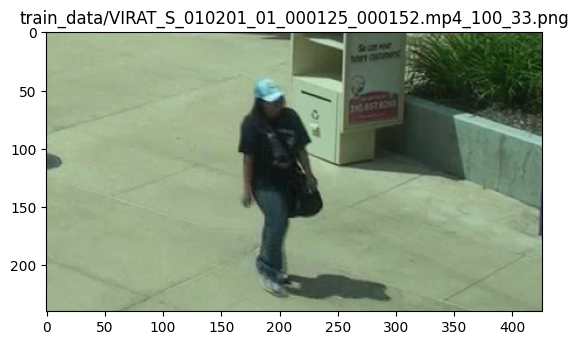

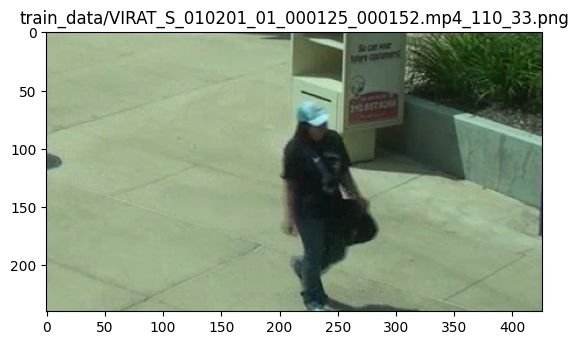

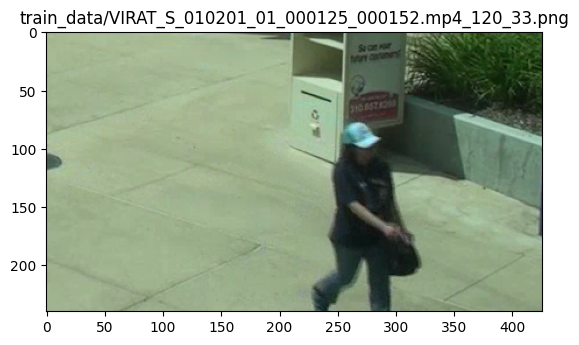



opening VIRAT_S_010200_04_000568_000620.mp4




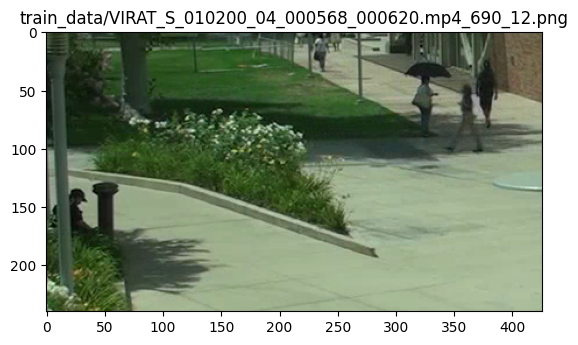

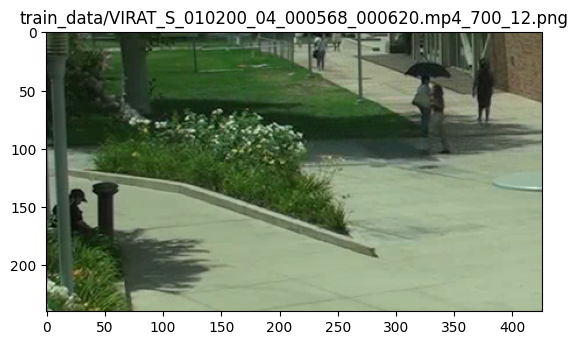

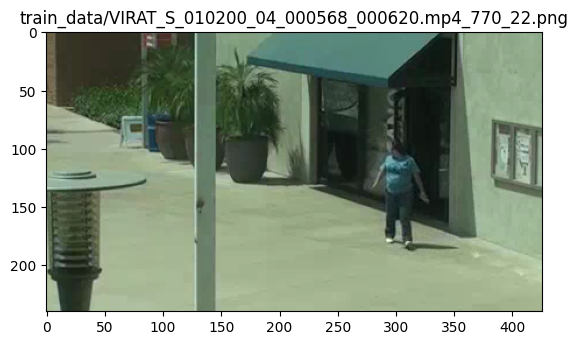

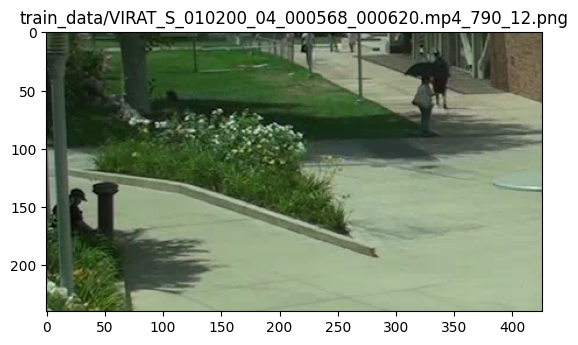

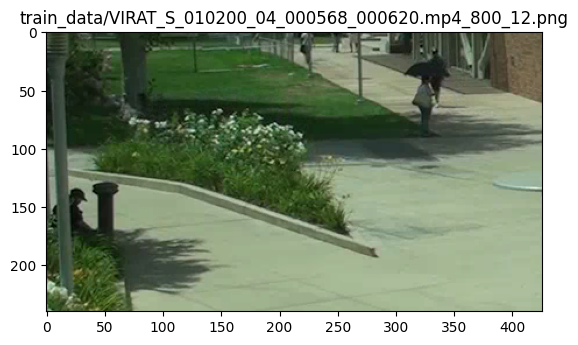

In [30]:
query = "a person wearing blue cap"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output2.csv")




opening VIRAT_S_010201_01_000125_000152.mp4




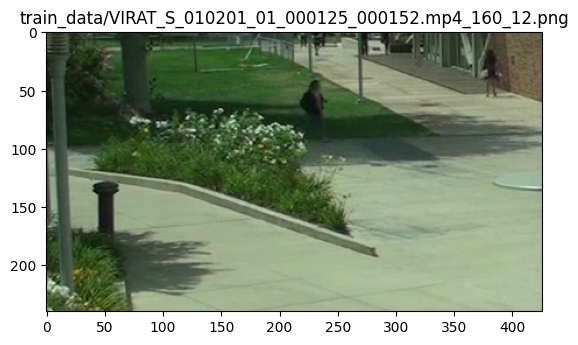

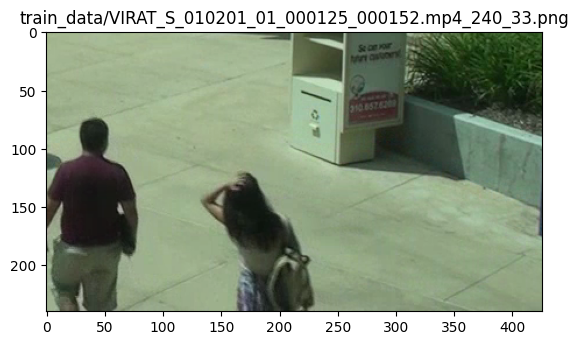

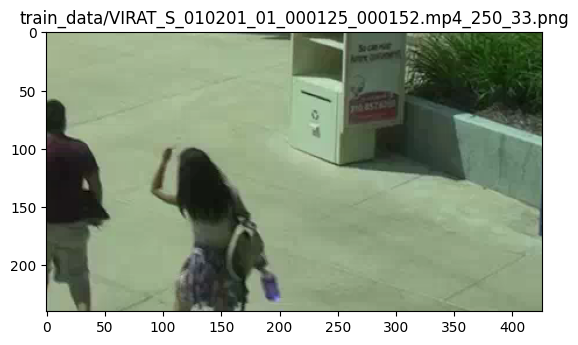

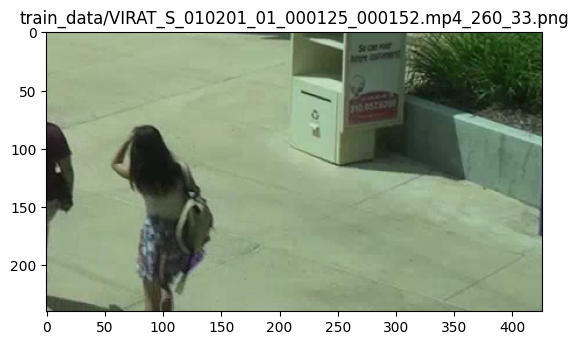

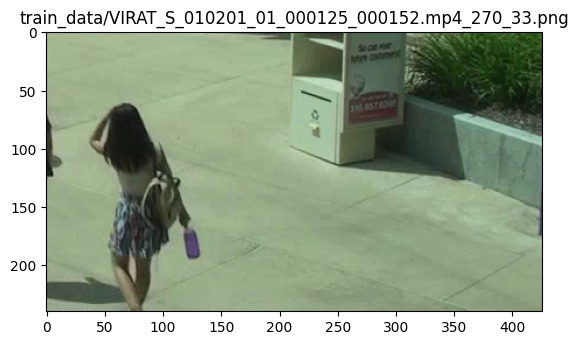

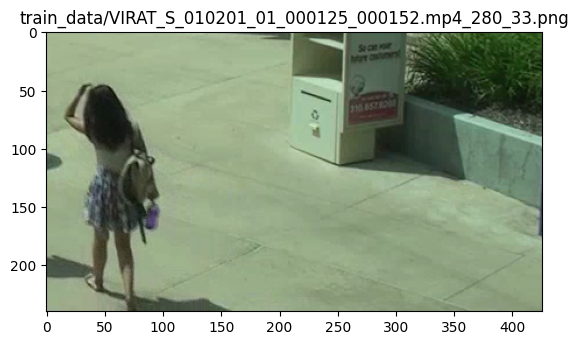



opening VIRAT_S_010200_04_000568_000620.mp4




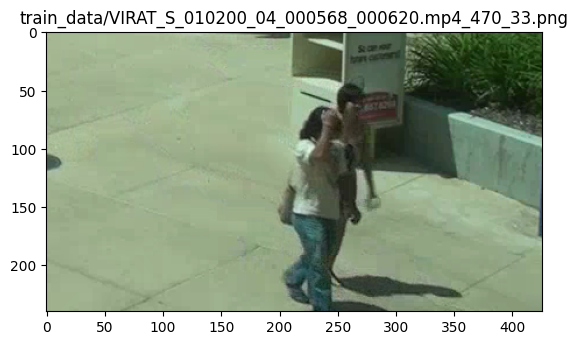

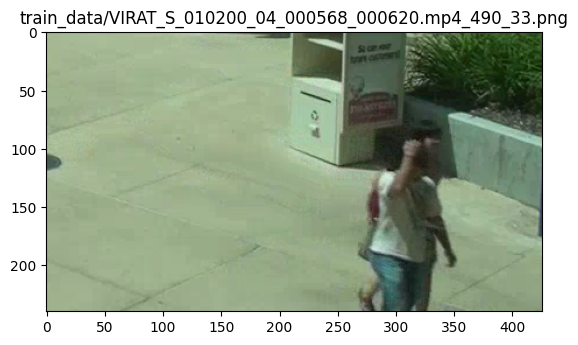

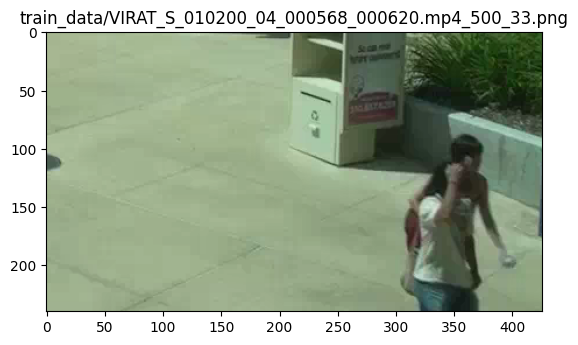

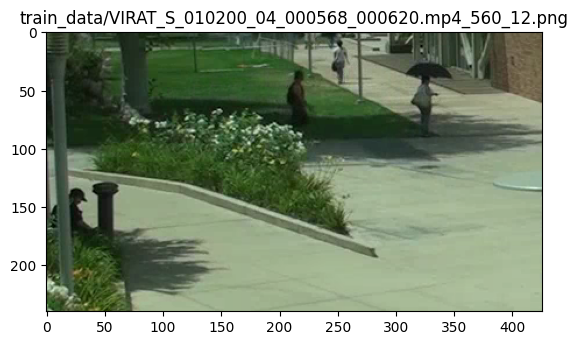

In [32]:
query = "a girl carrying purple bottle"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output3.csv")




opening VIRAT_S_010200_07_000748_000837.mp4




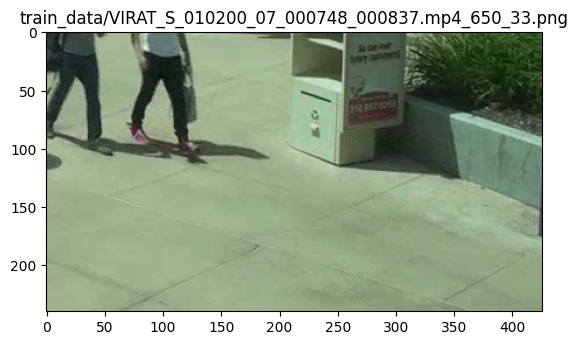

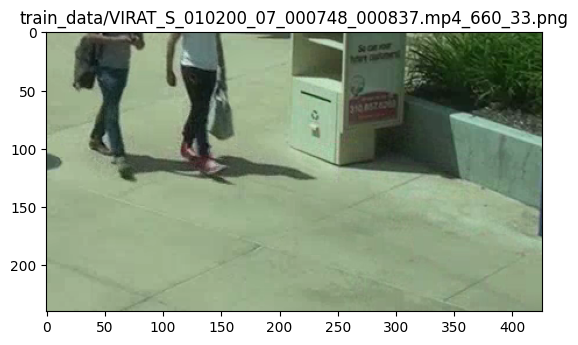

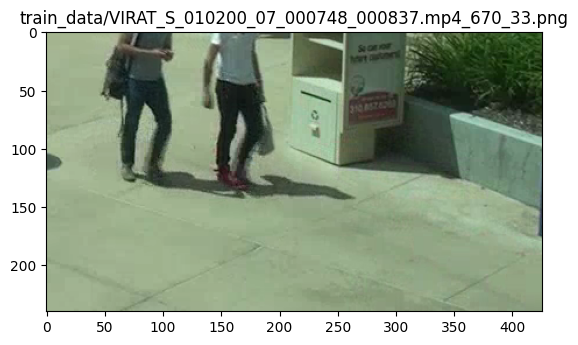

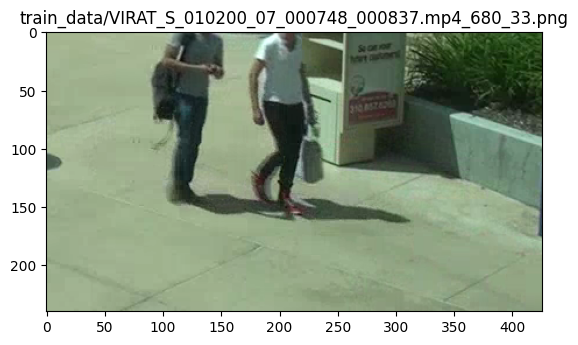

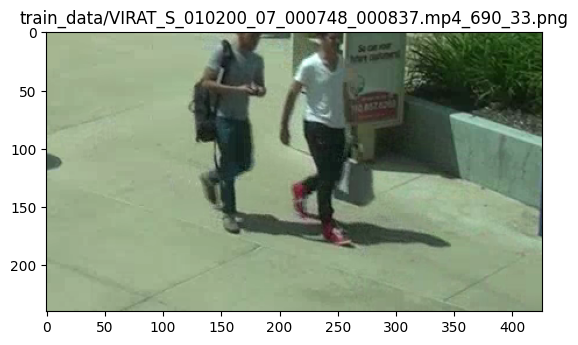

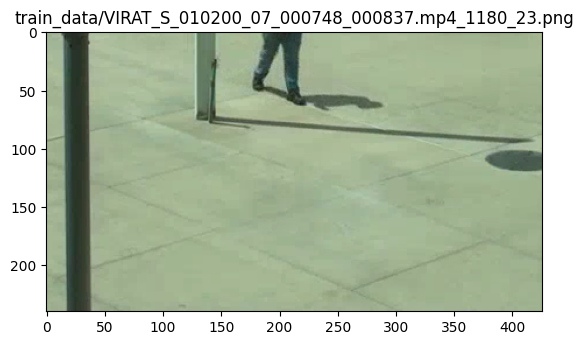

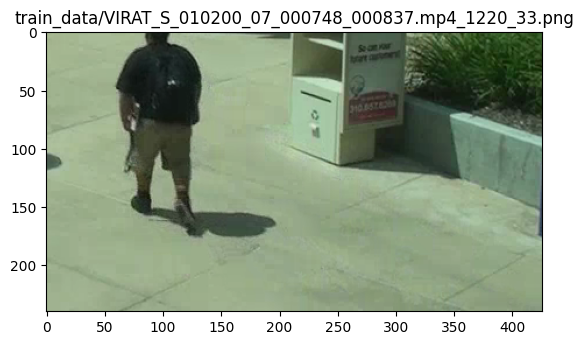

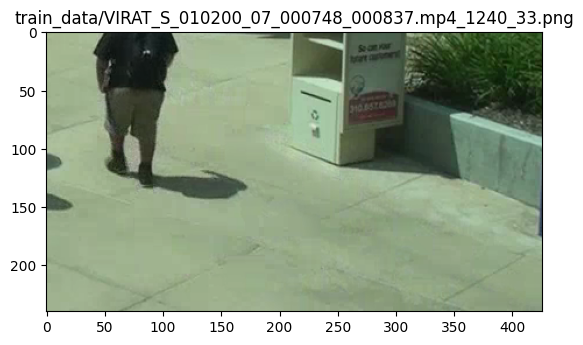

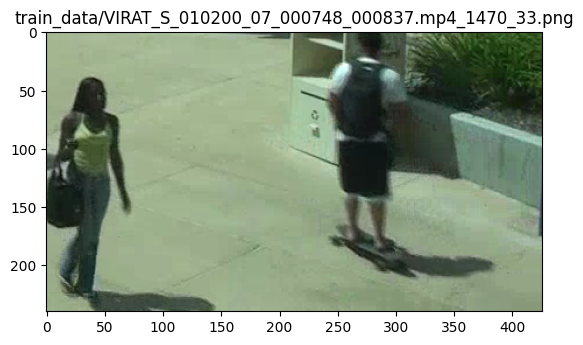

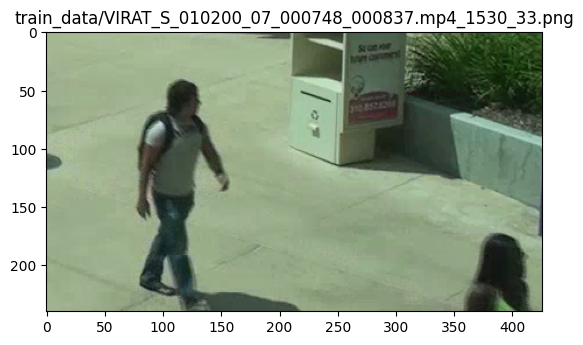

In [36]:
query = "a boy wearing red converse shoes"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output4.csv")




opening VIRAT_S_010200_07_000748_000837.mp4




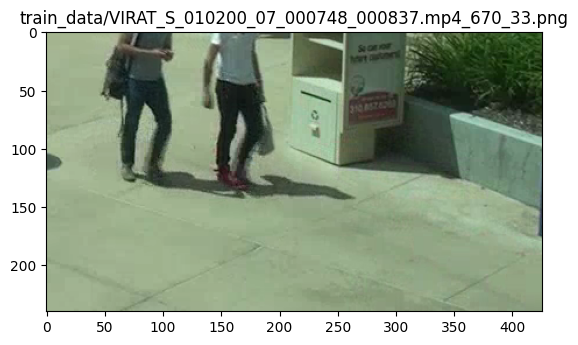

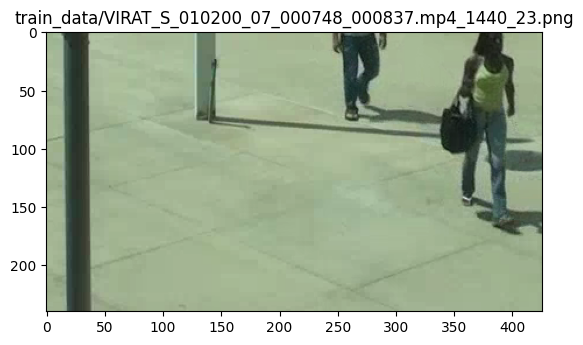

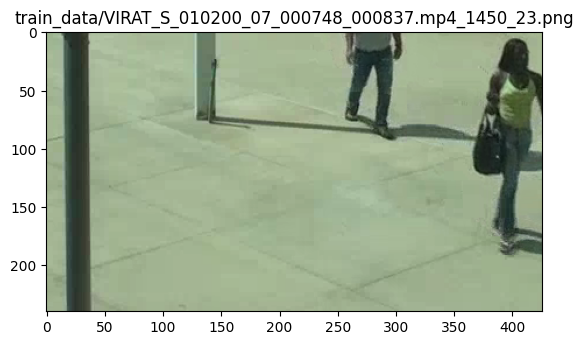

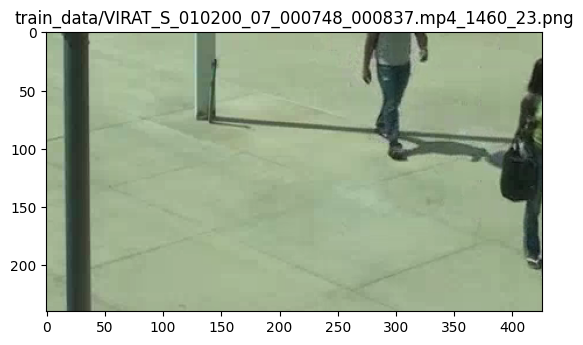

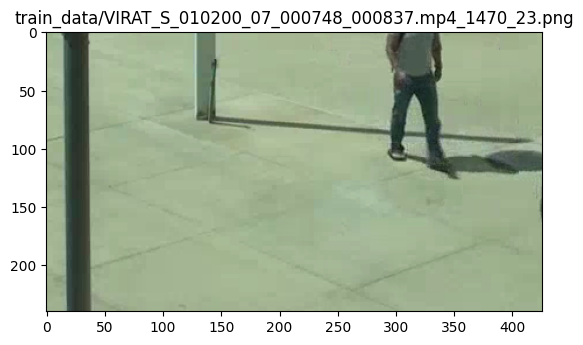

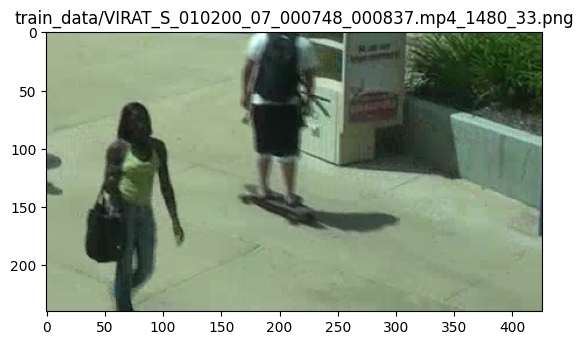

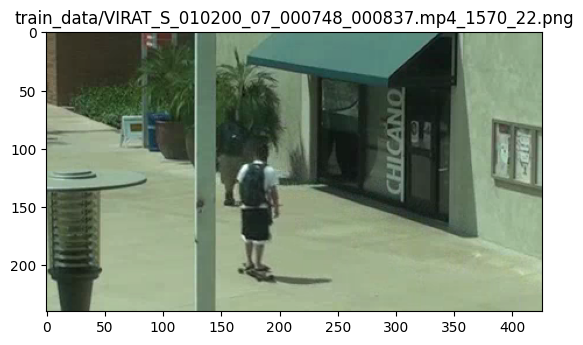



opening VIRAT_S_010200_04_000568_000620.mp4




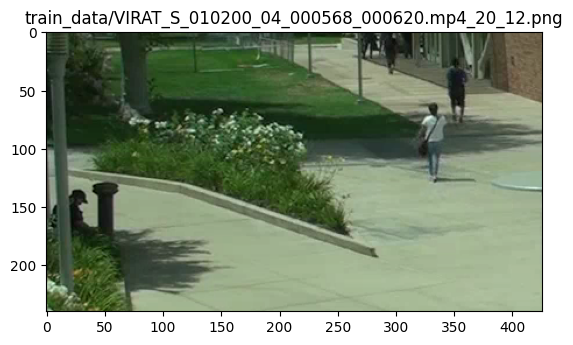

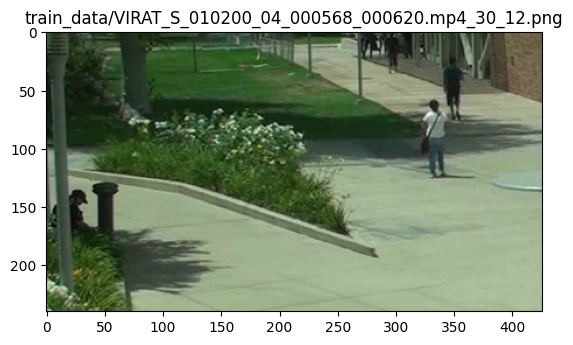

In [ ]:
query = "a guy in white tshirt riding skateboard"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output5.csv")




opening VIRAT_S_050301_01_000083_000320.mp4




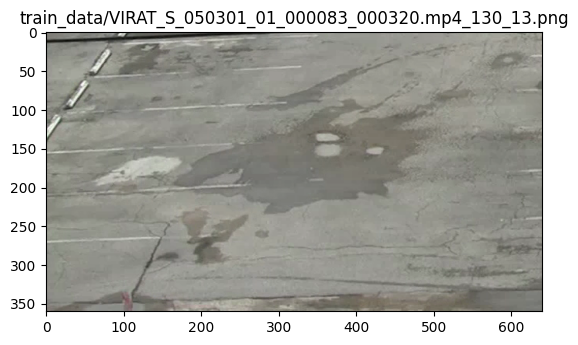

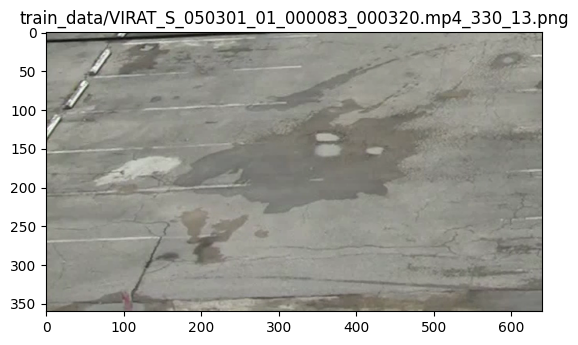

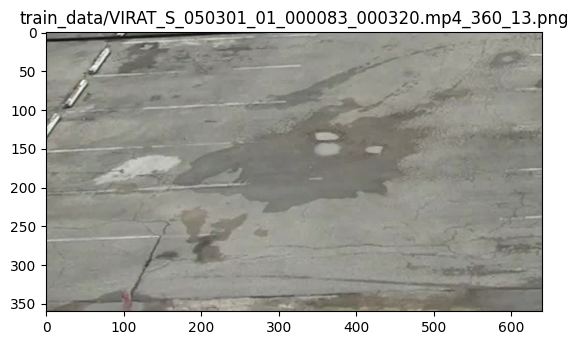

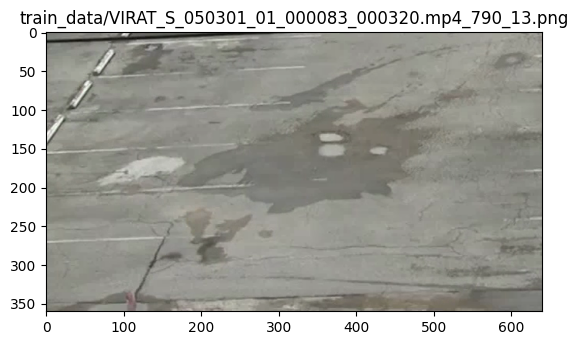

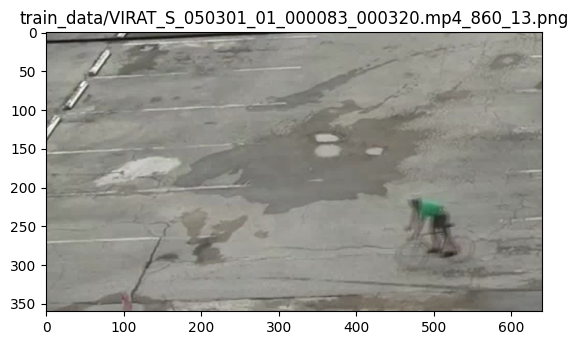

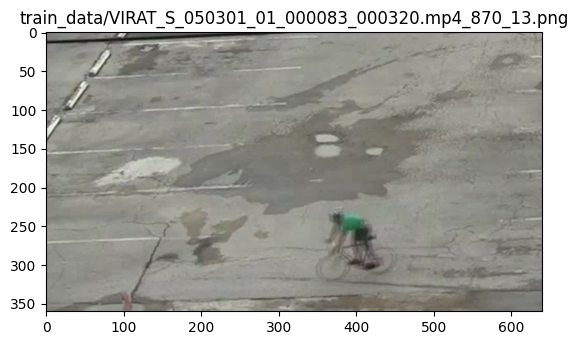

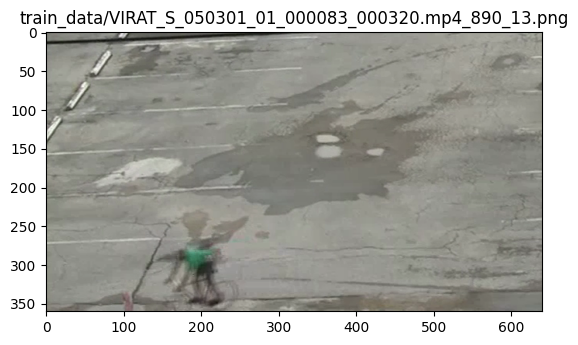

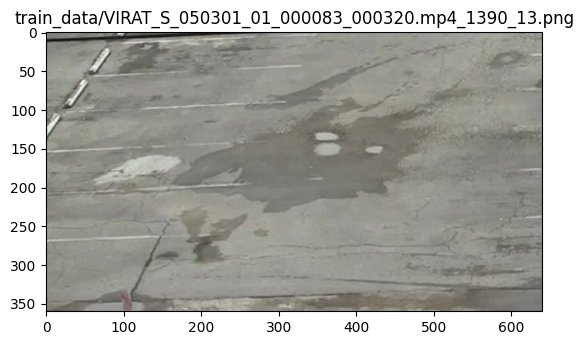

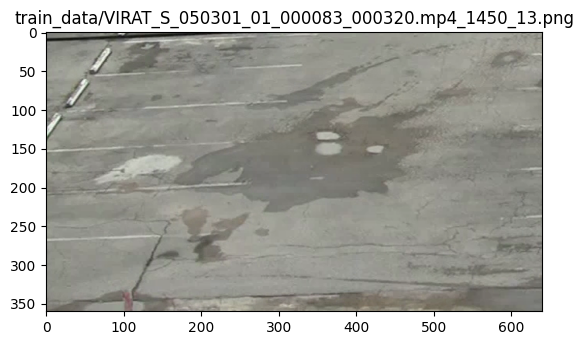

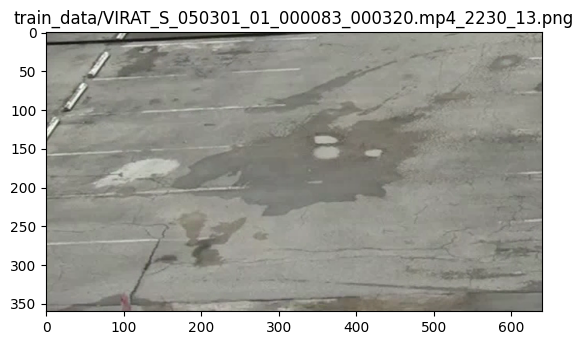

In [37]:
query = "a women with black umbrella"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output6.csv")




opening VIRAT_S_010200_04_000568_000620.mp4




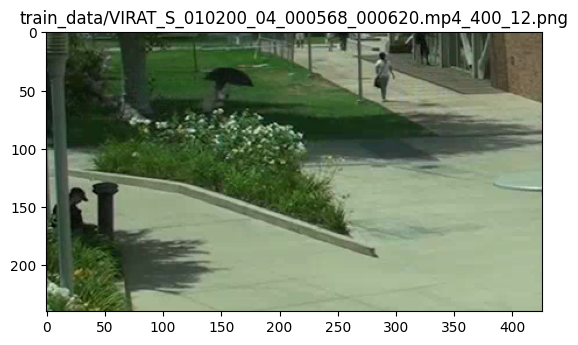

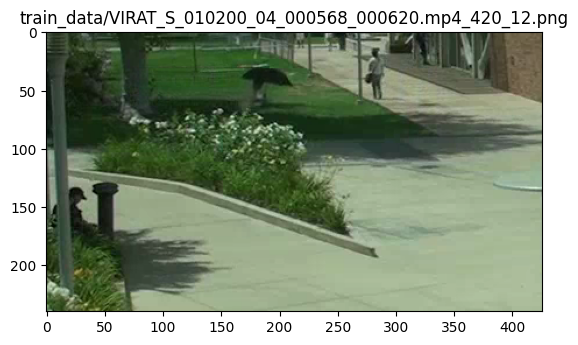



opening VIRAT_S_010201_01_000125_000152.mp4




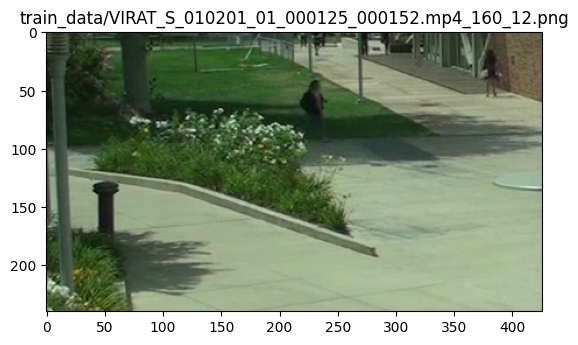



opening VIRAT_S_010200_07_000748_000837.mp4




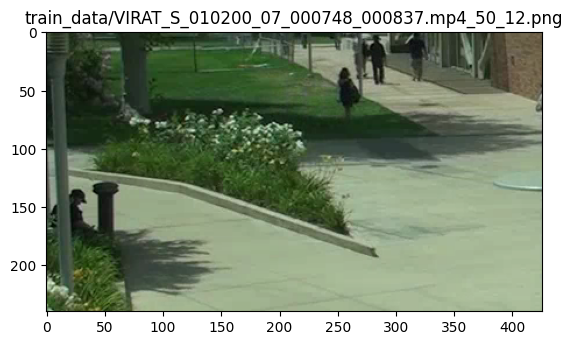

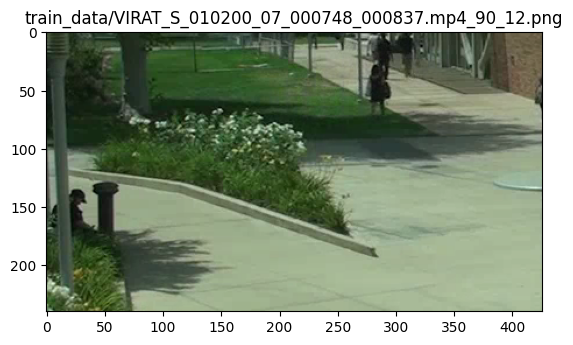

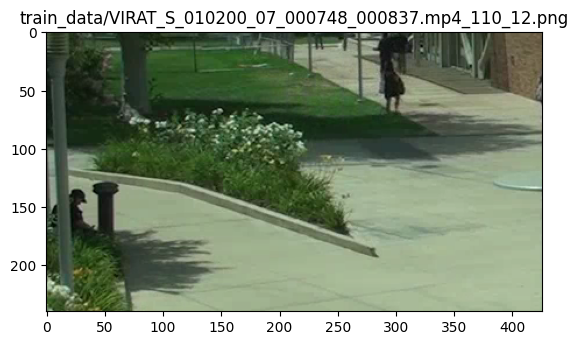

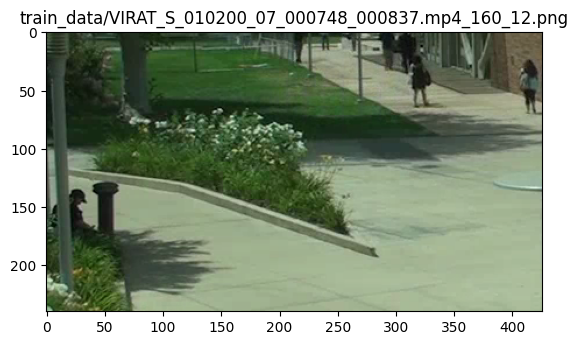

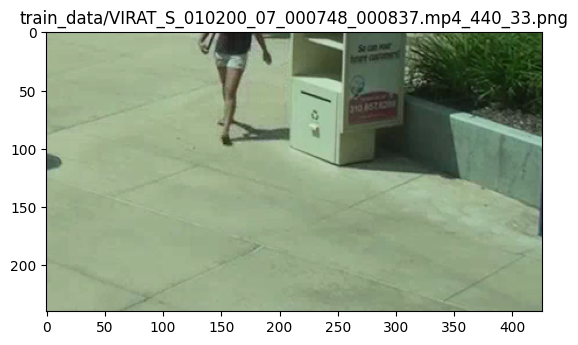

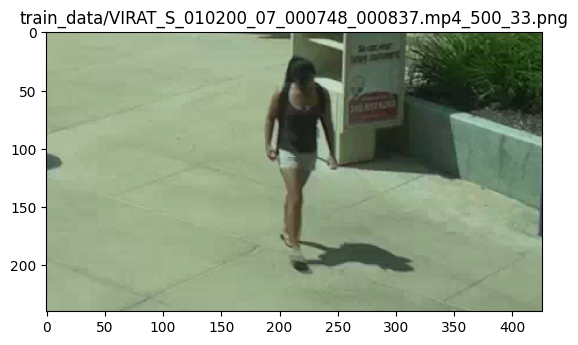

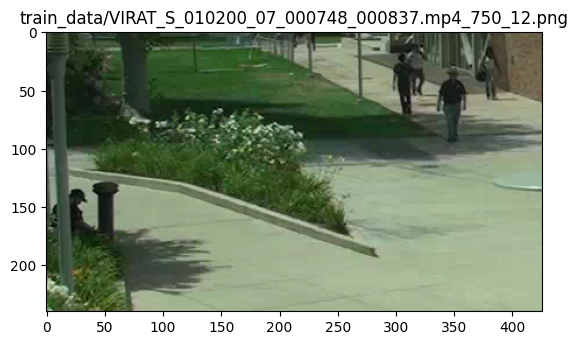

In [38]:
query = "a women with umbrella"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output7.csv")




opening VIRAT_S_010200_07_000748_000837.mp4




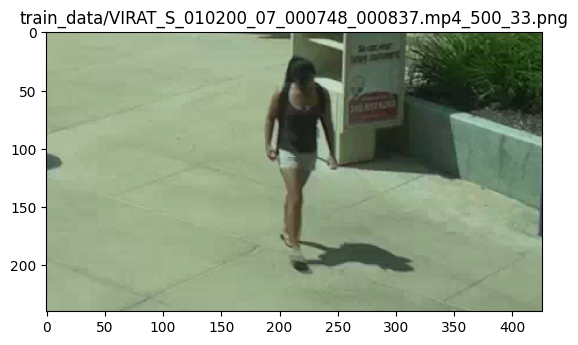

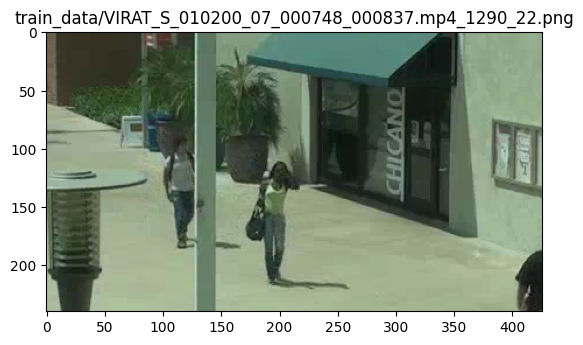

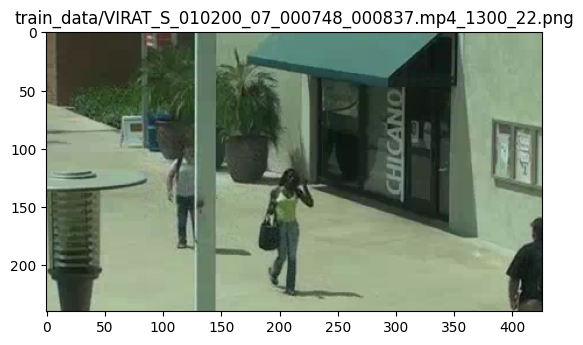

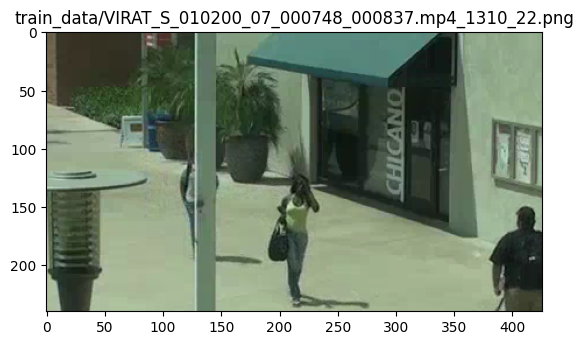

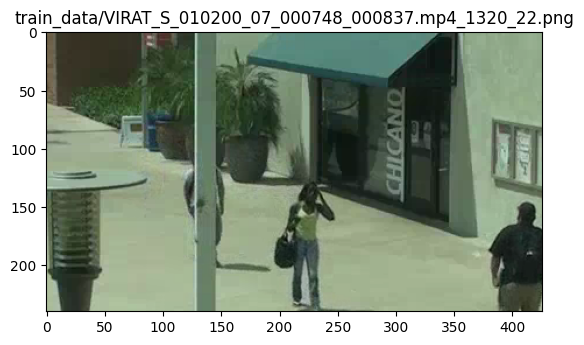

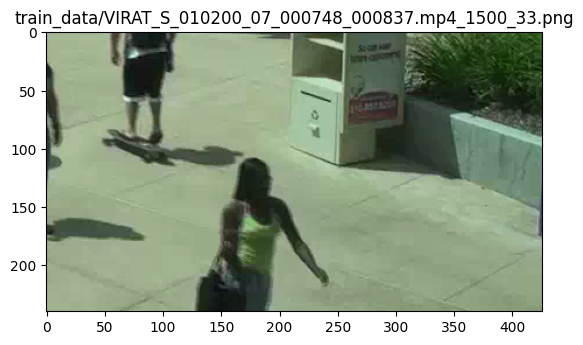



opening VIRAT_S_010201_01_000125_000152.mp4




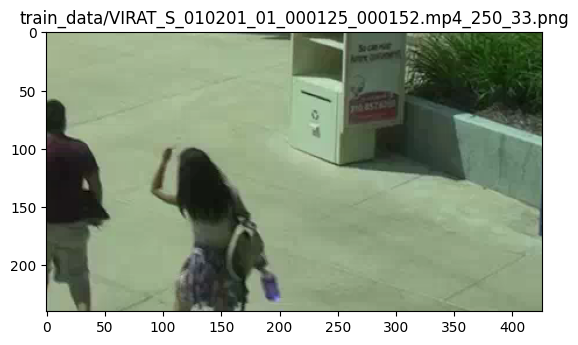

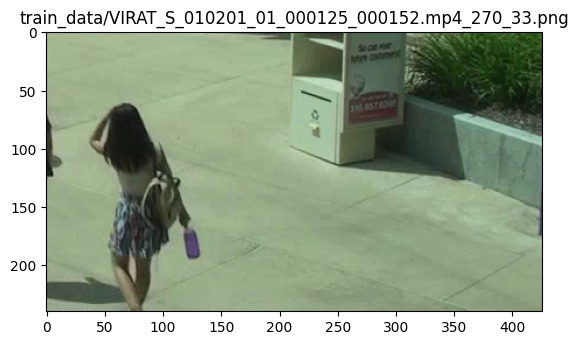

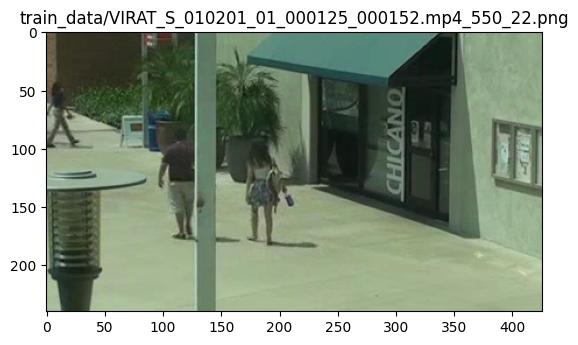



opening VIRAT_S_010200_04_000568_000620.mp4




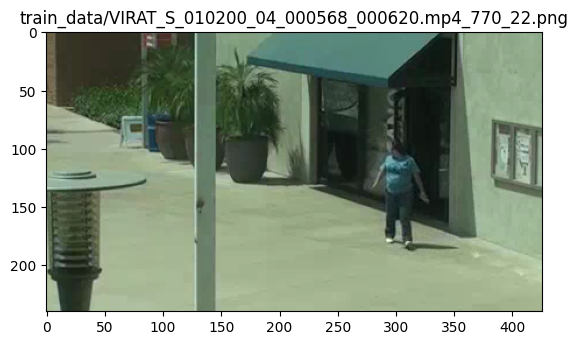

In [39]:
query = "a women in yellow top and a black tote bag"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output8.csv")




opening VIRAT_S_010200_07_000748_000837.mp4




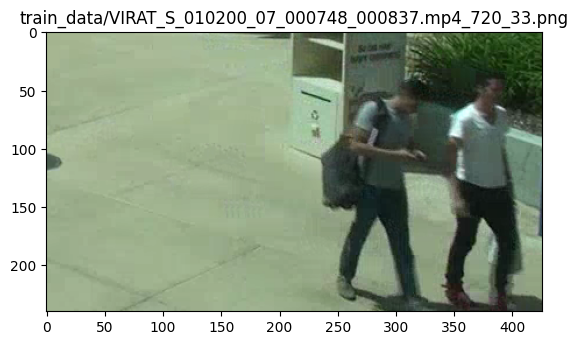

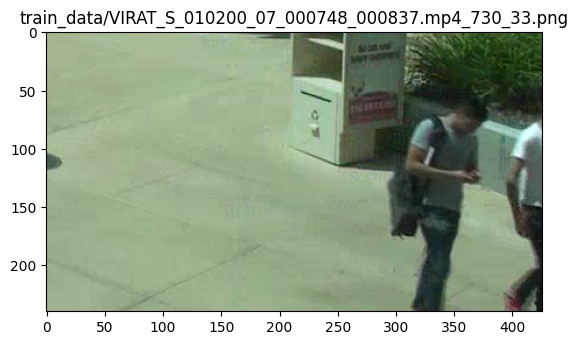

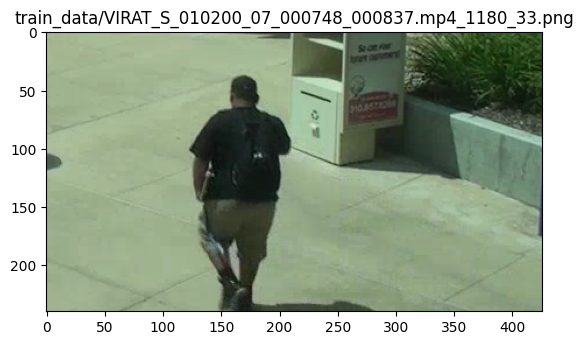

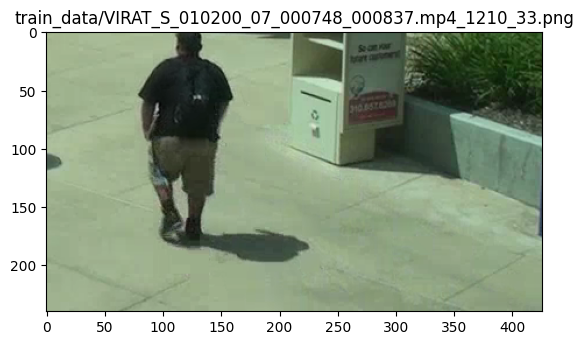

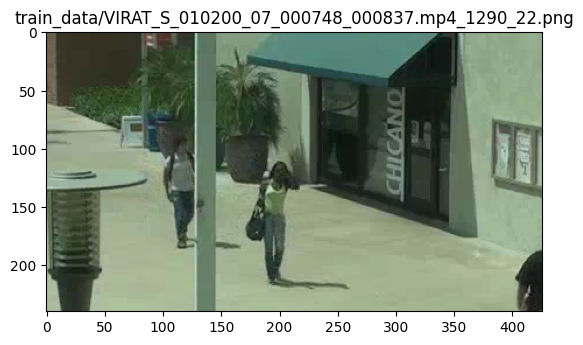



opening VIRAT_S_010201_01_000125_000152.mp4




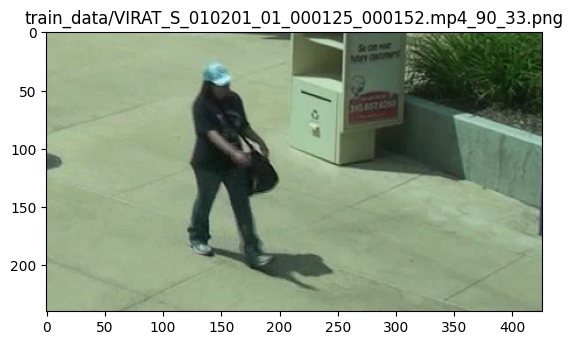

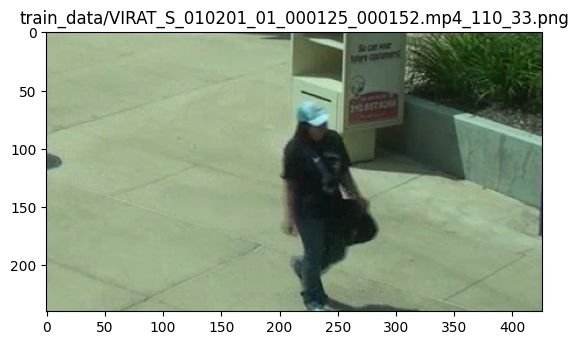

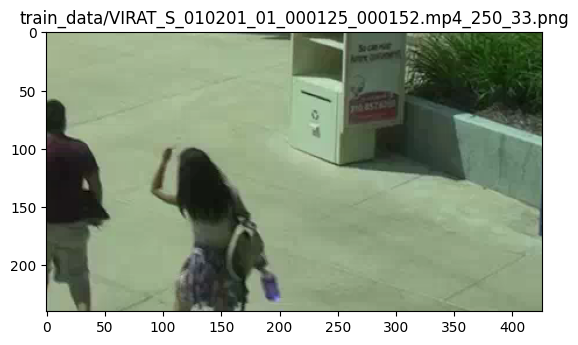

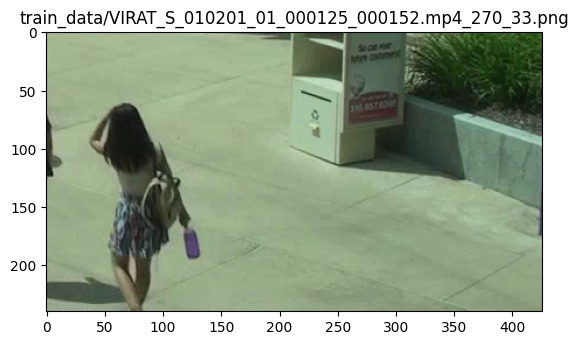

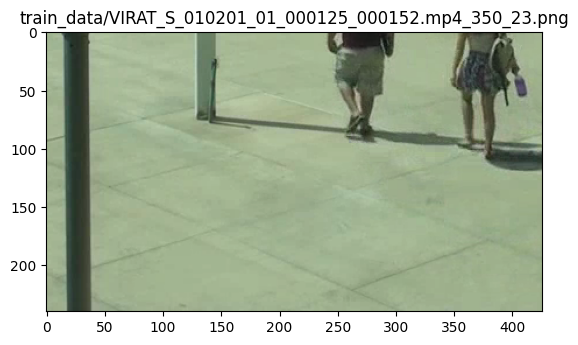

In [ ]:
query = "a person carrying a cabin bag"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output9.csv")




opening VIRAT_S_010201_01_000125_000152.mp4




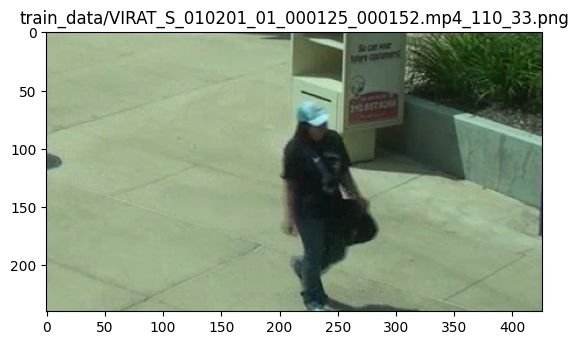

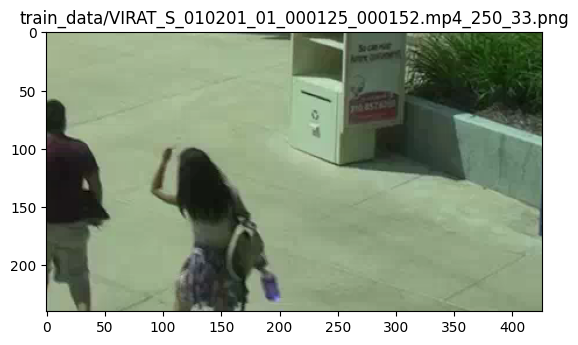

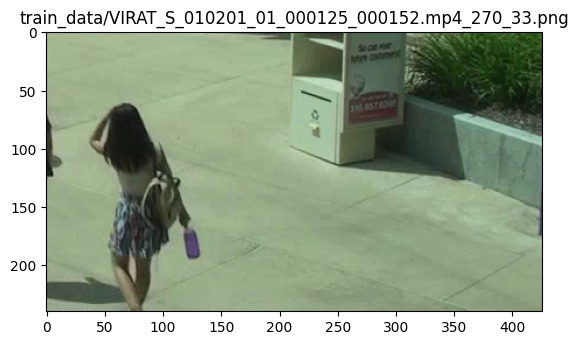

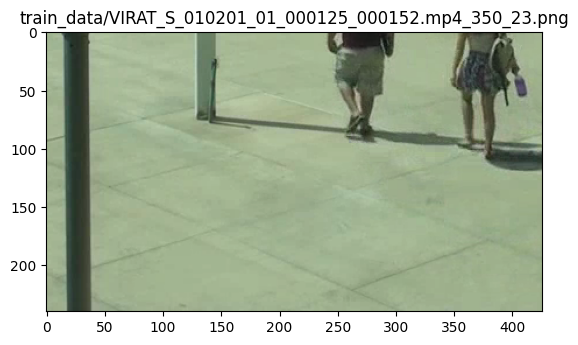



opening VIRAT_S_010200_07_000748_000837.mp4




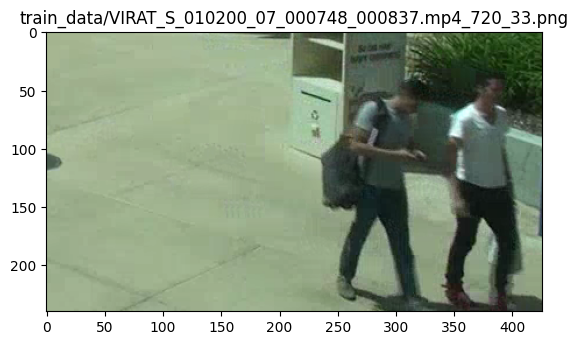

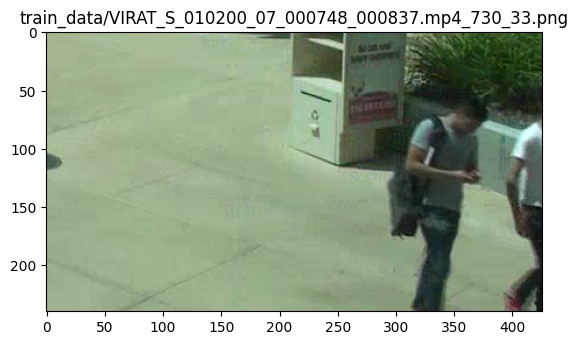

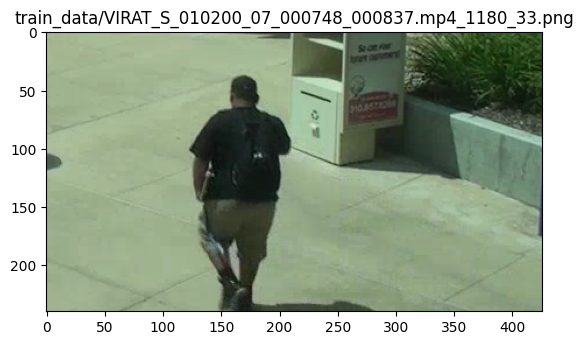

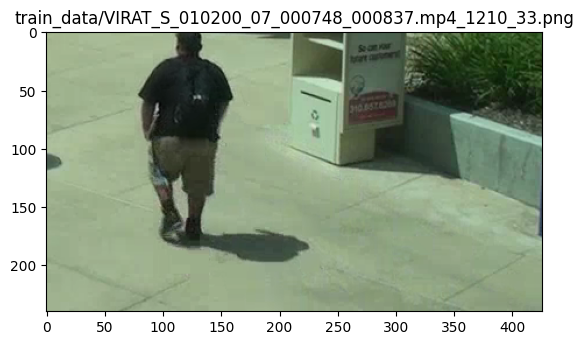

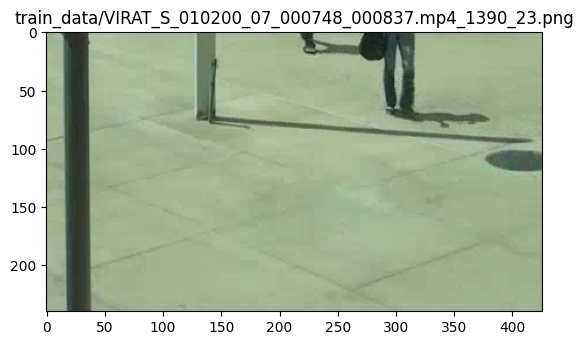

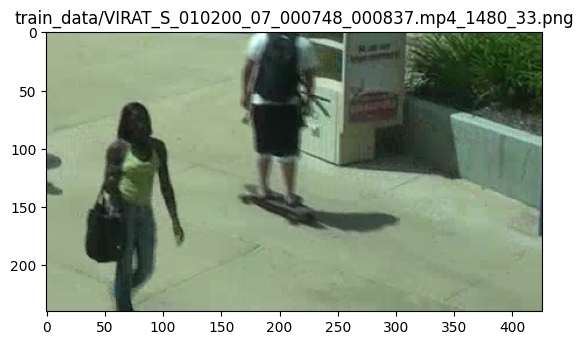

In [41]:
query = "a person carrying a trolley bag"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output10.csv")




opening VIRAT_S_010201_01_000125_000152.mp4




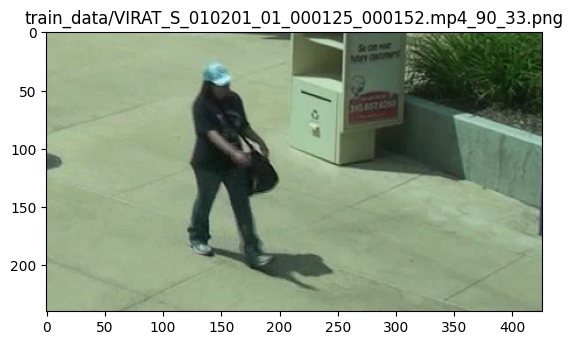

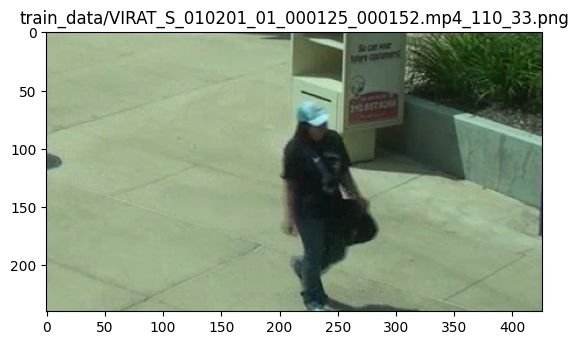

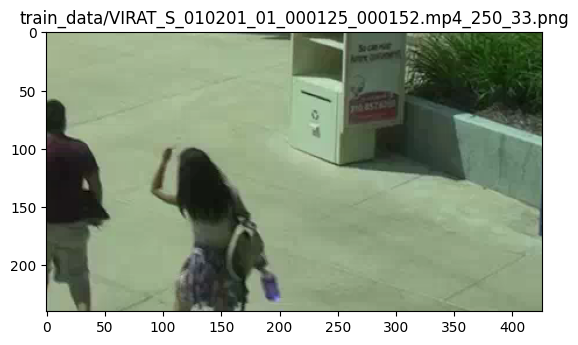

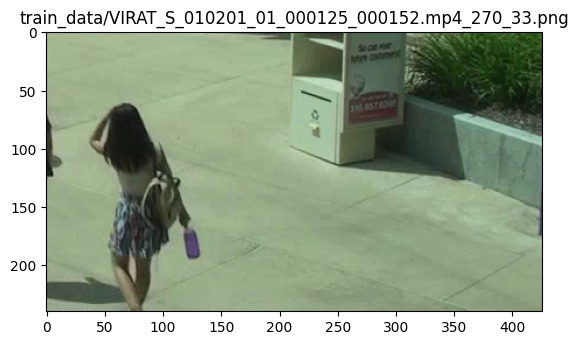

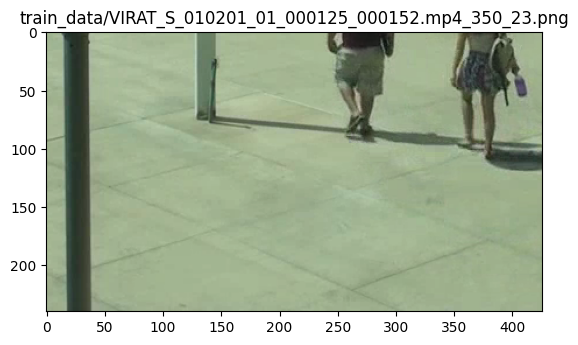



opening VIRAT_S_010200_07_000748_000837.mp4




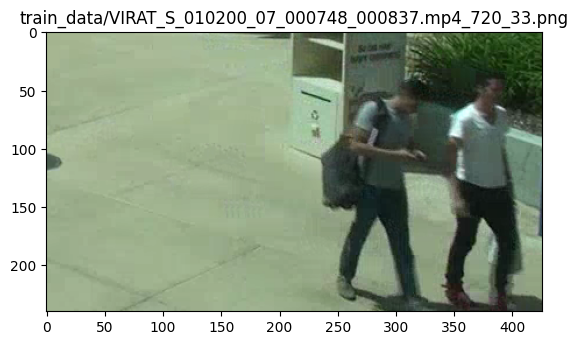

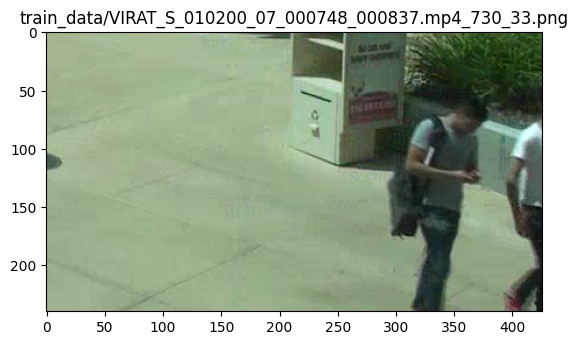

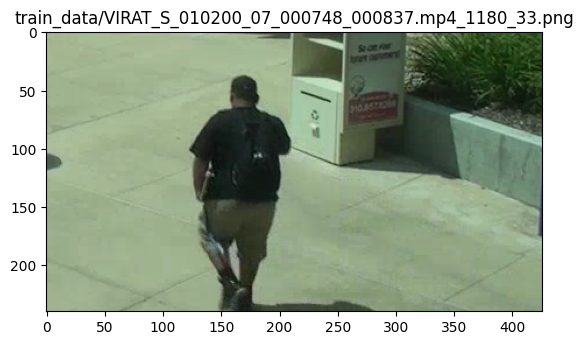

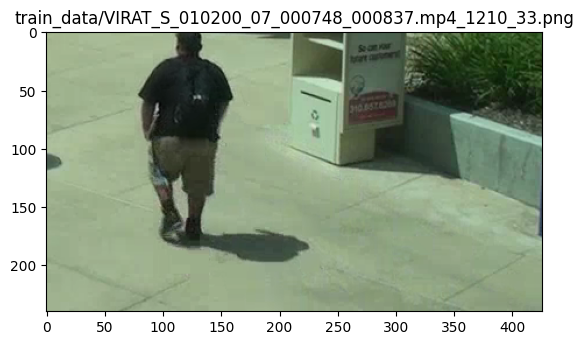

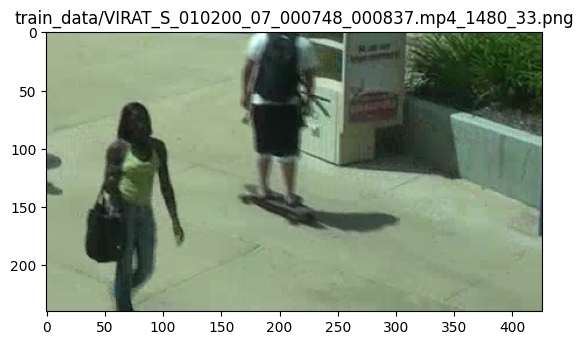

In [42]:
query = "a person carrying a black trolley bag"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output11.csv")




opening VIRAT_S_010200_04_000568_000620.mp4




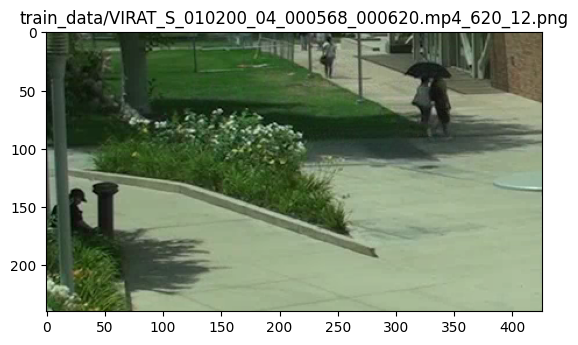

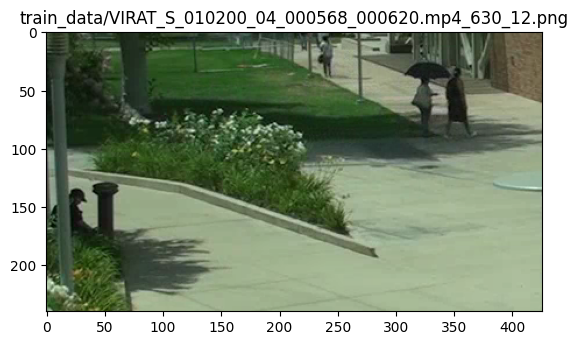

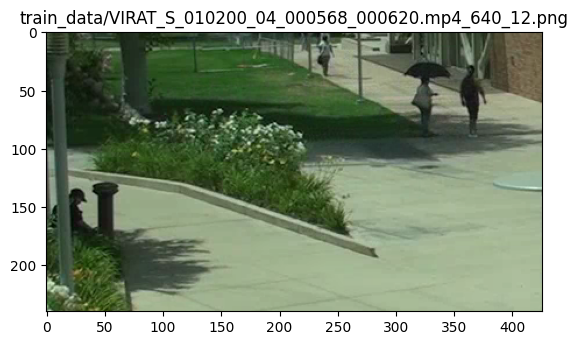

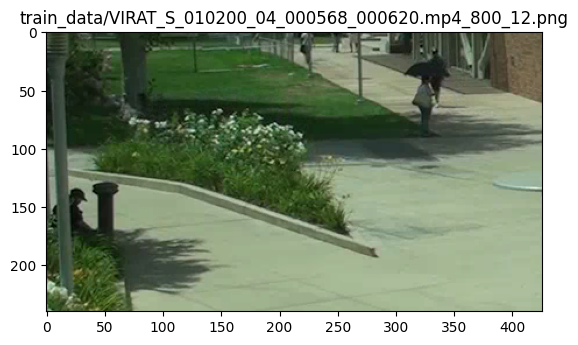

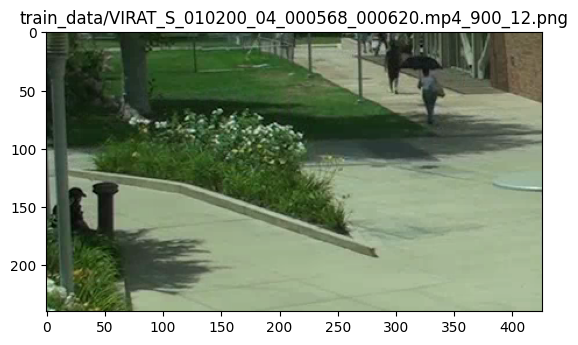



opening VIRAT_S_010200_07_000748_000837.mp4




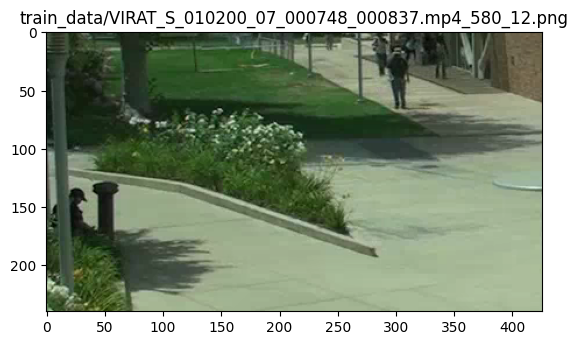

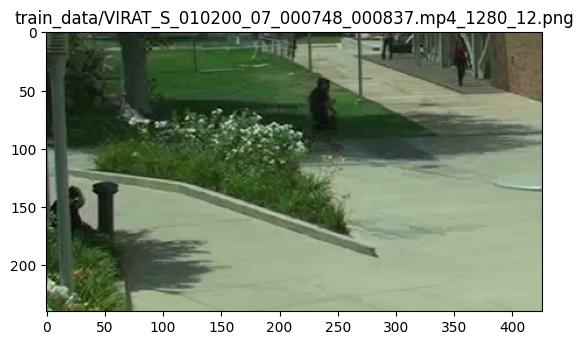

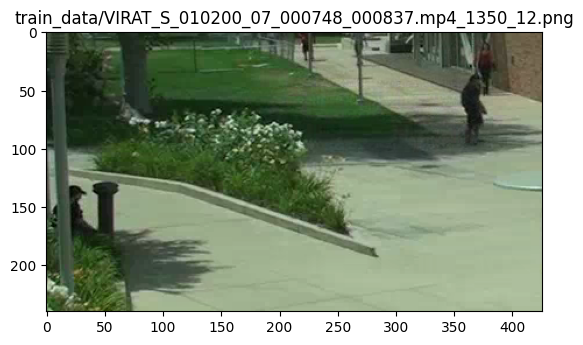

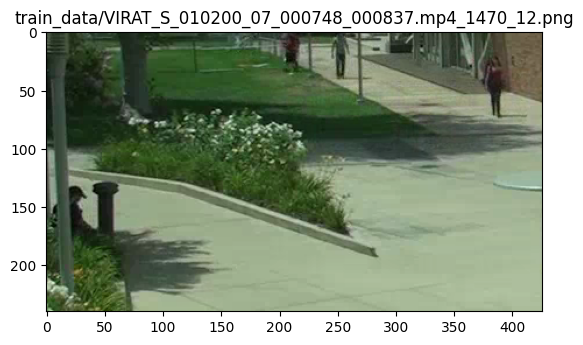



opening VIRAT_S_010201_01_000125_000152.mp4




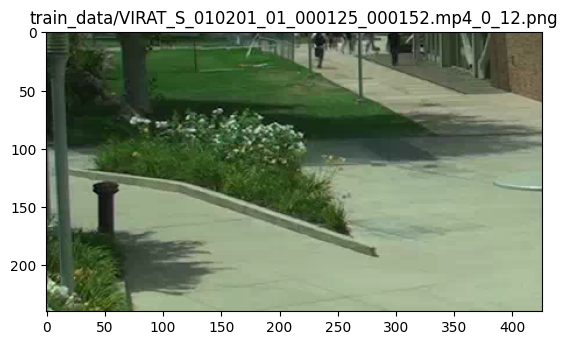

In [43]:
query = "a person riding a cycle"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output12.csv")




opening VIRAT_S_010200_04_000568_000620.mp4




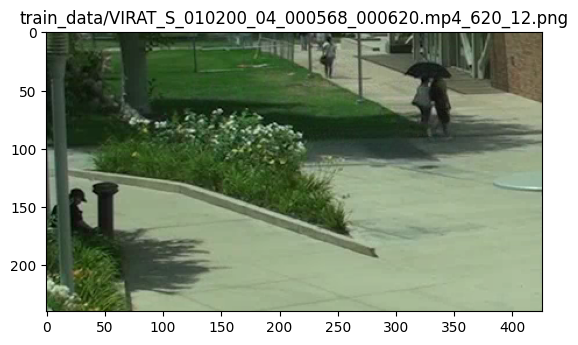

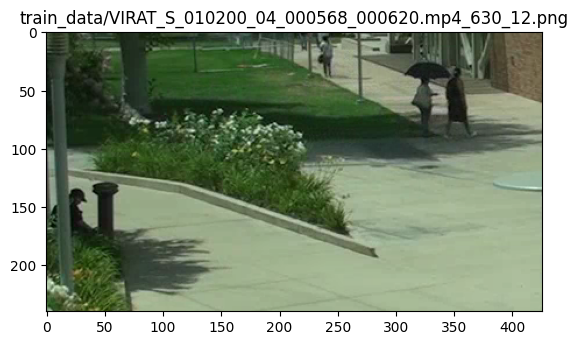

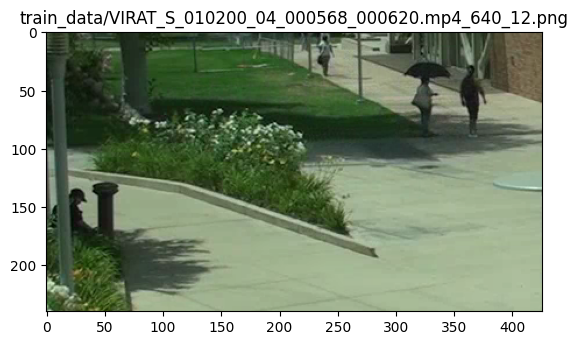

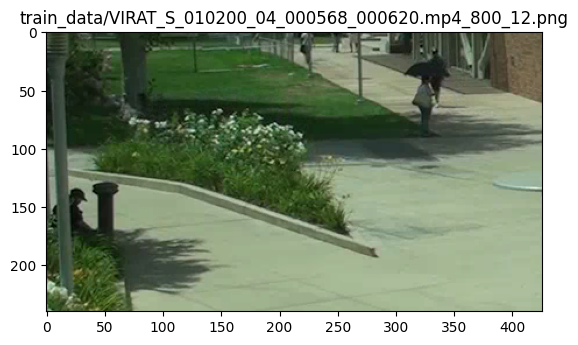



opening VIRAT_S_010200_07_000748_000837.mp4




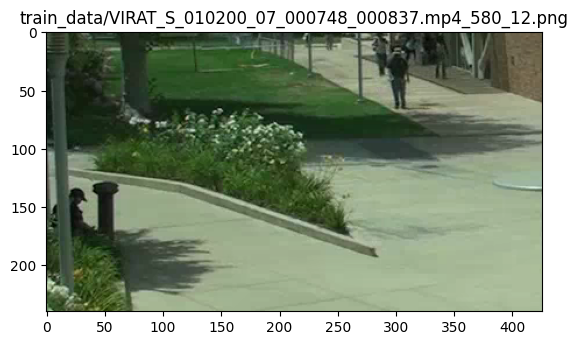

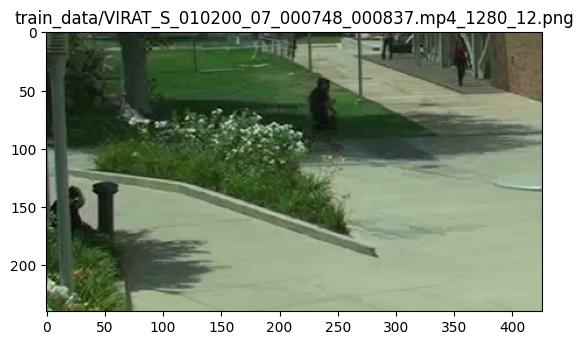

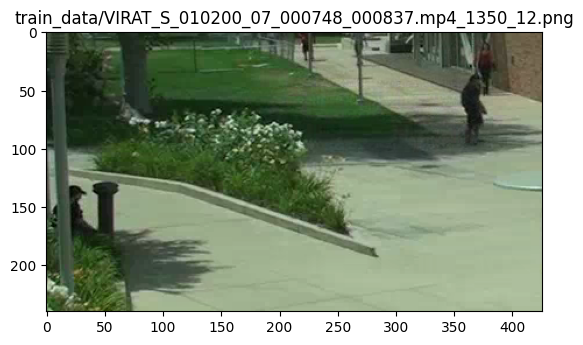

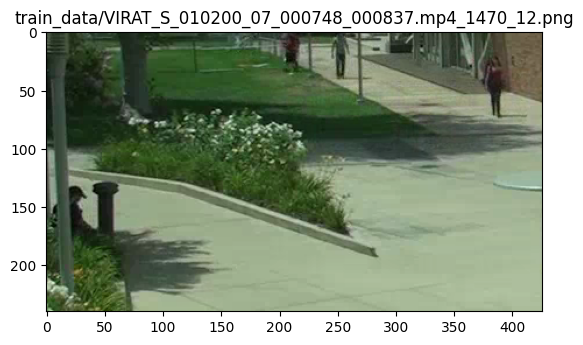

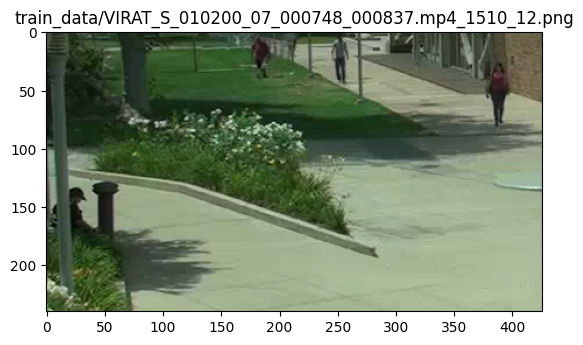



opening VIRAT_S_010201_01_000125_000152.mp4




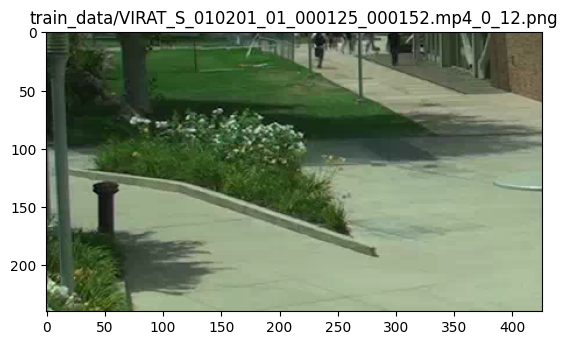

In [44]:
query = "a person riding a bicycle"
query_token = encode_text(query)
results = collection.query(
    query_embeddings=[query_token.numpy().tolist()[0]],
    include=["metadatas", "distances"],
    n_results=10)

video_timestamps , id_list = get_video_timestamps(results)
all_address = get_frames_crop_by_video(id_list)
save_images_and_csv(all_address, query, "output12.csv")


In [1]:
import os
import pandas as pd

data_list = []
caption_dict = {}

csv_folder = "/Volumes/D/UB_folders/sem2/UB_DL/Dl_final_project/project/dl_vision_bros/train_data/"
for i in range(1, 13):
    file_name = f"output{'' if i == 1 else i}.csv"
    full_path = os.path.join(csv_folder, file_name)

    df = pd.read_csv(full_path)

    for _, row in df.iterrows():
        caption = row["caption"]
        image_filename = os.path.basename(row["id"]) 
        is_valid = row["valid"]

        if caption not in caption_dict:
            caption_dict[caption] = {
                "caption": caption,
                "positive_images": [],
                "negative_images": []
            }

        if is_valid == 1:
            caption_dict[caption]["positive_images"].append(image_filename)
        else:
            caption_dict[caption]["negative_images"].append(image_filename)

data_list = list(caption_dict.values())


In [2]:
data_list

[{'caption': 'a person in green tshirt ridiing a bicycle',
  'positive_images': ['VIRAT_S_050301_01_000083_000320.mp4_800_23.png',
   'VIRAT_S_050301_01_000083_000320.mp4_810_23.png',
   'VIRAT_S_050301_01_000083_000320.mp4_820_23.png'],
  'negative_images': ['VIRAT_S_010200_04_000568_000620.mp4_620_12.png',
   'VIRAT_S_010200_04_000568_000620.mp4_630_12.png',
   'VIRAT_S_010200_04_000568_000620.mp4_640_12.png',
   'VIRAT_S_010200_04_000568_000620.mp4_650_12.png',
   'VIRAT_S_010200_04_000568_000620.mp4_660_12.png',
   'VIRAT_S_010200_04_000568_000620.mp4_680_12.png',
   'VIRAT_S_010200_04_000568_000620.mp4_800_12.png']},
 {'caption': 'a person wearing blue cap',
  'positive_images': ['VIRAT_S_010201_01_000125_000152.mp4_80_33.png',
   'VIRAT_S_010201_01_000125_000152.mp4_90_33.png',
   'VIRAT_S_010201_01_000125_000152.mp4_100_33.png',
   'VIRAT_S_010201_01_000125_000152.mp4_110_33.png',
   'VIRAT_S_010201_01_000125_000152.mp4_120_33.png'],
  'negative_images': ['VIRAT_S_010200_04_0005